In [2]:
#using Pkg
#Pkg.add("Images")
#Pkg.add("MAT")


    Updating registry at `C:\Users\khala\.julia\registries\General.toml`


   Resolving package versions...


  No Changes to `C:\Users\khala\.julia\environments\v1.9\Project.toml`
  No Changes to `C:\Users\khala\.julia\environments\v1.9\Manifest.toml`

   Resolving package versions...


  No Changes to `C:\Users\khala\.julia\environments\v1.9\Project.toml`
  No Changes to `C:\Users\khala\.julia\environments\v1.9\Manifest.toml`


In [1]:
using Distributed
@everywhere using LinearAlgebra
@everywhere using MAT
@everywhere using Plots
@everywhere using Images

In [2]:
pyplot()

file = matopen("project_data.mat")
img = read(file, "im")
sources = read(file,"sources")
rgb = read(file,"rgb")
close(file)

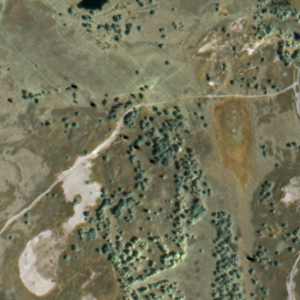

In [3]:
# visualize data in rgb (using bands 67,109,141 as th RGB channels)
p1 = colorview(RGB,permutedims(rgb,(3,1,2))) # convert 3d array to the image format used by julia

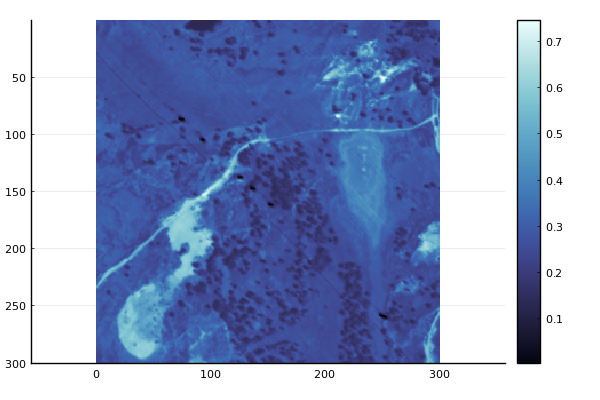

In [4]:
#visualize a spectral band on its own
p2 = heatmap(img[:,:,150],aspect_ratio=1, yflip = true,c=:ice)

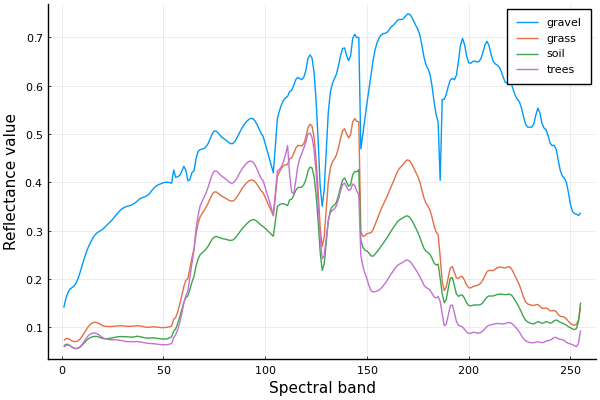

In [5]:
# visualize the endmembers to be used

plot(sources[:,1],label = "gravel")
plot!(sources[:,2],label = "grass")
plot!(sources[:,3],label = "soil")
plot!(sources[:,4],label = "trees")
xlabel!("Spectral band")
ylabel!("Reflectance value")

# Unmixing the image

The model we are using to decompose the image into the sum of the contributions of the endmembers is:

\begin{equation*}
\mathbf{X} = \mathbf{S}\mathbf{A} + \mathbf{E} 
\end{equation*}

 $\mathbf{X}\in \mathbb{R}^{L\times N}$ : data matrix
 
 $\mathbf{S}\in \mathbb{R}^{L\times P}$ : endmember matrix
 
 $\mathbf{A}\in \mathbb{R}^{P\times N}$ : abundance matrix
 
 $\mathbf{E}\in \mathbb{R}^{L\times N}$ : additive noise matrix
 
 where $L$ is the number of spectral bands, $P$ is the number of materials, and $N$ is the number of pixels
 
 The hyperspectral image is represented as a matrix with $N$ pixels, so the first thing to do is to reshape the image to a big matrix.

We can try and estimate the abundance matrix using a least squares formulation:

\begin{equation*}
\hat{A} = \underset{\mathbf{A}>\mathbf{0}, \mathbf{1}_{P}^T \mathbf{A} = \mathbf{1}_{N}^{T} }{\textrm{arg min}}\frac{1}{2}||\mathbf{X}-\mathbf{SA}||_{F}^{2} = \underset{\mathbf{A}>\mathbf{0}, \mathbf{1}_{P}^T \mathbf{A} = \mathbf{1}_{N}^{T} }{\textrm{arg min}}\frac{1}{2} \sum_{n=1}^{N} ||\mathbf{x}_{n}-\mathbf{S}\mathbf{a}_{n}||_{2}^{2}
\end{equation*}

where $\mathbf{1}_{.}$ is a vector of ones whose size is given in index 

Choose an algorithm to solve the optimization problem, and implement it both in a serial version and a version parallelized across the pixels.

## I- Unmixing Problem Resolution

### 1- Problem definition

We define the loss function $f$ which is a matrix entry function defined as : 
$$ f(\mathbf{A}) = \frac{1}{2}||\mathbf{X}-\mathbf{SA}||_{F}^{2}  $$
The problem is to minimize $f$ with the following constraints : 
1. $\mathbf{A}\geq 0$ (positive value matrix)
2. $\mathbf{1}_{P}^T \mathbf{A} = \mathbf{1}_{N}^{T}$

We define the unit simplex with $P$ vertices by the subspace of $\mathbb{R}^{P}$ verifying :
$$\Delta^P = \left\{(a_1,\dots,a_P) \in \mathbb{R}_+^P\, : \, \sum_{p=1}^P a_{p}  = 1 \right\} $$

Hence, the problem's contraints are equivalent to say that the columns of the input matrix are elements of the unit simplex $\Delta^P$.



### 2- Choice of algorithm


In order to resolve the problem we use a projected gradient descent on $f$. During each backtracking, we project all the columns in $\Delta^P$ : 
$$ \mathbf{A}^{(n+1)} = \text{proj}_\mathcal{S}\left(\mathbf{A}^{(n)} - \rho \nabla f(\mathbf{A}^{(n)}) \right) $$
where $\mathcal{S}$ is the constraints space and $\nabla f$ the gradient of $f$ in the Frobenius norm sense given by : 
$$\nabla f(\mathbf{A}) = \mathbf{S}^T \mathbf{S} \mathbf{A} - \mathbf{S}^T \mathbf{X} $$
This result comes from the 1st order Taylor expansion of $f(\mathbf{A} + \mathbf{H}) - f(\mathbf{A})$ where $\mathbf{H}$ is a matrix with a small norm of Frobenius. 



### 3- Projection function

In [6]:
# ref: https://arxiv.org/pdf/1101.6081.pdf
@everywhere function projsplx(y)
        m = length(y)
        bget = false;
        s = sort(y,rev=true) 
        tmpsum = 0
        for ii = 1:m-1
            tmpsum = tmpsum + s[ii]
            tmax = (tmpsum - 1)/ii
            if tmax >= s[ii+1]
                bget = true
                break
            end
        end
            
        if !bget
            tmax = (tmpsum + s[m] -1)/m
        end
        x = max.(y.-tmax,0)
        return x
end

### 3- Serial Processing on a smaller dataset

We start by croping the image in order to do a serial processing of the algorithm

In [7]:
L = 255; # number of spectral bands
P = 4; # number of endmembers
Nx_crop = 100;
Ny_crop = 100;
N = Nx_crop * Ny_crop; # dimension of the cropped image

# croping the image and defining involved matrices
X = img[1:Nx_crop,1:Ny_crop,:]; # use a small crop of the image first
X = transpose(reshape(X,N,L));
S = sources;


Here we define our projected gradient descent function.

In [8]:
# Backtracking & projection on simplex
#-------------
@everywhere function backtracking(x,f,∇f,d)
    """
    bactracking: 
    see e.g. https://web.stanford.edu/~boyd/cvxbook/bv_cvxbook.pdf - p.464
    IN:
    ---
    x: initial point
    f, ∇f: function to be minimized and its gradient
    d: searc direction
    OUT:
    ----
    y: final point
    n: number of loops
    """
    
    n_iter_max = 10

    α = 1/4 # choose in [0, 1/2[
    β = 0.7 # choose in [0,1[
    ρ = 1
    n = 0
    y  = x + ρ * d
    while f(y)  > f(x) + α * ρ * tr(∇f(x)'* d)  && n < n_iter_max 
        ρ *= β
        y  = x + ρ * d

        # Projection on the simplex
        y = map(projsplx, eachcol(y)) 
        y = hcat(y...)
        n += 1
    end
    return y, n
end


In [9]:
@everywhere function proj_grad(N, X)    
    precision = 1.e-3 * N
    max_iter  = 100 
    init = 1e-9 * randn(P, N)
    init = max.(init,0)
    init = map(projsplx, eachcol(init))
    init = hcat(init...)
    # Gradient algorithm
    # with backtracking
    #-------------------
    f(A) = tr((X - S * A) * (X - S * A)')
    ∇f(A) = transpose(S) * S * A - transpose(S) * X
    
    pt             = init
    nb_iter_grad   = 0  # number of loops
    nb_loops_grad  = 0  # number of inner loops count for backtracking
    resu_grad      = pt

    nr = sqrt(tr(∇f(pt)'* ∇f(pt))) # gradient norm
    while  nr > precision && nb_iter_grad<max_iter
        pt, n_back     = backtracking(pt, f, ∇f, -∇f(pt))
        nb_loops_grad += n_back
        nb_iter_grad  += 1
        resu_grad      = pt
        nr = sqrt(tr(∇f(pt)'* ∇f(pt))) 
        println(" iter $nb_iter_grad : ||∇f|| is equal to $nr")

    end
    println("Total number of loops $nb_loops_grad")
    resu_grad
end

In [10]:
@time resu_grad = proj_grad(N, X)

 iter 1 : ||∇f|| is equal to 770.7113182059418
 iter 2 : ||∇f|| is equal to 625.5367090563896
 iter 3 : ||∇f|| is equal to 589.5109587411083
 iter 4 : ||∇f|| is equal to 577.0041682014026
 iter 5 : ||∇f|| is equal to 568.1000504435053
 iter 6 : ||∇f|| is equal to 561.4113845278325
 iter 7 : ||∇f|| is equal to 557.9406517213646
 iter 8 : ||∇f|| is equal to 555.0496967803635
 iter 9 : ||∇f|| is equal to 552.6187335195839
 iter 10 : ||∇f|| is equal to 550.5618128595064
 iter 11 : ||∇f|| is equal to 548.8101066211974
 iter 12 : ||∇f|| is equal to 547.3066964638484
 iter 13 : ||∇f|| is equal to 545.9935104225352
 iter 14 : ||∇f|| is equal to 544.8341582529581
 iter 15 : ||∇f|| is equal to 543.7863110791392
 iter 16 : ||∇f|| is equal to 542.8225058443375
 iter 17 : ||∇f|| is equal to 541.938421427448
 iter 18 : ||∇f|| is equal to 541.1064259519295
 iter 19 : ||∇f|| is equal to 540.307574119367
 iter 20 : ||∇f|| is equal to 539.5445337296907
 iter 21 : ||∇f|| is equal to 538.8259735368135
 it

4×10000 Matrix{Float64}:
 0.0690118  0.0762375  0.0599384  0.0       …  0.0283412  0.0295461  0.056367
 0.545853   0.580511   0.649851   0.498551     0.599768   0.532629   0.487259
 0.0        0.0        0.0        0.297594     0.065101   0.251309   0.273405
 0.385135   0.343251   0.290211   0.203855     0.30679    0.186516   0.182969

We can see that the time consumed by the algorithm is around 445 seconds. 

The hessian matrix of $f$ is given by : 
$$\nabla^2 f (\mathbf{A}) = \mathbf{S}^T \mathbf{S}. $$

Since $f$ is quadratic with the input $\mathbf{A}$, we verify the convexity of $f$ by computing the eigenvalues of $\nabla^2 f$ whether they are all positive of not. 

### 4- Serial processing results vizualization

Let's first visualize the cropped image in RGB.

In [11]:
rgb_crop = rgb[1:100,1:100,:];

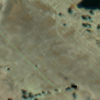

In [12]:
p2 = colorview(RGB,permutedims(rgb_crop,(3,1,2)))

In [14]:
A_hat = reshape(resu_grad, P, Nx_crop, Ny_crop); # reshaping the resulting A 

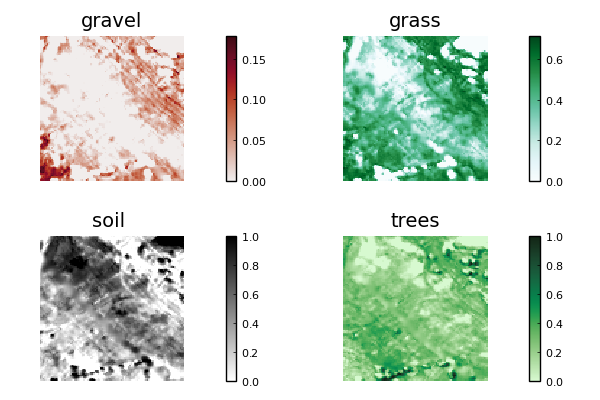

In [15]:
p = plot(layout=grid(2,2),framestyle =:none, title = "Unmixing of the cropped image")
plot!(p[1],A_hat[1,:,:],title = "gravel",seriestype=:heatmap,aspect_ratio=1, yflip = true,c=:amp)
plot!(p[2],A_hat[2,:,:],title = "grass",seriestype=:heatmap,aspect_ratio=1, yflip = true,c=:BuGn_9)
plot!(p[3],A_hat[3,:,:],title = "soil ", seriestype=:heatmap,aspect_ratio=1, yflip = true,c=:binary)
plot!(p[4],A_hat[4,:,:],title = "trees", seriestype=:heatmap,aspect_ratio=1, yflip = true,c=:algae)

In [28]:
size(img_hat)

(100, 100, 255)

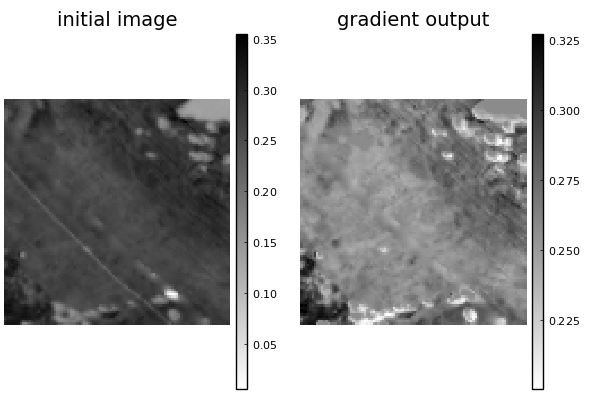

In [31]:
# Lets see the resulting image in a the spectral band 150 and compare it to the one displayed above
img_hat = S * resu_grad
img_hat = transpose(img_hat)
img_hat = reshape(img_hat,Nx_crop, Ny_crop,L)
p3 = plot(layout=grid(1,2),framestyle =:none)
plot!(p3[1],img[1:100,1:100,150],title = "initial image",seriestype=:heatmap,aspect_ratio=1, yflip = true,c=:binary)
plot!(p3[2],img_hat[:,:,150],title = "gradient output",seriestype=:heatmap,aspect_ratio=1, yflip = true,c=:binary)


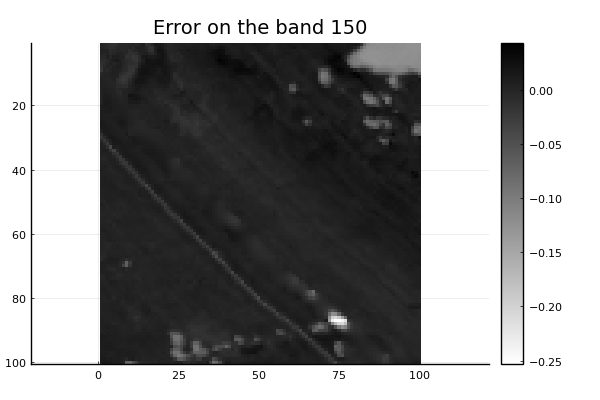

In [32]:
error = img[1:100,1:100,:] - img_hat
plot(.abs(error[:,:,150].^2),title = "Error on the band 150",seriestype=:heatmap,aspect_ratio=1, yflip = true,c=:binary)

## Parallel Computing:

### I- Parallel computing with 25 processes on the cropped image

Lets try in this part a parallelization using 25 workers by dividing the cropped image into 25 parts and applying the projected back propagation algorithm parallely on the 25 parts.

In [25]:
# Displaying the number of processes and workers
using Distributed
println("Number of processes: $(nprocs())");
println("Number of workers: $(nworkers())")

Number of processes: 1
Number of workers: 1


In [26]:
img_crop = img[1:100,1:100,:];

In [27]:
# Here we define the function to divide an image
function divider(div_factor, img)
    # div_factor: the coefficient divider of a baseline of the image: In our case, the image will be divided in div_factor^2 sub_images. 
    width_img = size(img)[1]
    δ = round(Int64,width_img/div_factor); # length along one axis of the sub-images
    X_all = [transpose(reshape(img[1+i*δ : (i+1)*δ, 1+j*δ : (j+1)*δ, : ],δ^2, L) ) for i = 0:div_factor-1 for j = 0:div_factor-1]
    return X_all
end

divider (generic function with 1 method)

In [28]:
# vector of 25 parts of the image
div_factor = 5
X_all = divider(div_factor, img_crop);

In [29]:
# defining the necessary variables for all processes
@everywhere L = 255;
@everywhere P = 4;
@everywhere file = matopen("project_data.mat")
@everywhere sources = read(file,"sources")
N = 20*20; 
@everywhere S = sources;



In [30]:
# adding processes to have 25 workers
# After adding them.
addprocs(25)
nprocs()
nworkers()

In [27]:
# parallelization using 25 workers
@time res = pmap(X -> proj_grad(N, X),X_all);

      From worker 26:	 iter 1 : ||∇f|| is equal to 55.1992138925266
      From worker 22:	 iter 1 : ||∇f|| is equal to 165.95256329723983
      From worker 26:	 iter 2 : ||∇f|| is equal to 30.78816909619774
      From worker 23:	 iter 1 : ||∇f|| is equal to 80.46213761359888
      From worker 24:	 iter 1 : ||∇f|| is equal to 168.40748386509642
      From worker 20:	 iter 1 : ||∇f|| is equal to 68.29592833981522
      From worker 22:	 iter 2 : ||∇f|| is equal to 153.97064620647404
      From worker 10:	 iter 1 : ||∇f|| is equal to 151.2978046286394
      From worker 2:	 iter 1 : ||∇f|| is equal to 111.98531843742366
      From worker 8:	 iter 1 : ||∇f|| is equal to 155.35229809462658
      From worker 6:	 iter 1 : ||∇f|| is equal to 150.16830831702617
      From worker 17:	 iter 1 : ||∇f|| is equal to 107.66642849307004
      From worker 26:	 iter 3 : ||∇f|| is equal to 24.41699487717744
      From worker 3:	 iter 1 : ||∇f|| is equal to 56.04885908181919
      From worker 23:	 iter 2 : 

In [62]:
# function to concatenate the arrays in the X_all vector in order to have a single array with the good shape
function inv_divider(size, width_img)
    δ = round(Int64,width_img/size);
    res_resh =[reshape(res[i], 4, δ,δ) for i =1:length(res)]
    res2 = zeros(Float16, 4, width_img, width_img);

    for i = 0:size-1
        for j= 0:size-1
            res2[:, 1+j*δ : (j+1)*δ, 1+i*δ : (i+1)*δ] = res[i+1+size*j]
        end
    end
    return res2
end

inv_divider (generic function with 3 methods)

In [63]:
# visualizing the result
res2 = inv_divider(5, 100)
heatmap(res2[4,:,:],title = "grass visualization",aspect_ratio=1, yflip = true,c=:BuGn_9)

LoadError: DimensionMismatch: new dimensions (4, 20, 20) must be consistent with array size 14400

### 2- Parallelization on all the image

We will test different parallelizations and we will choose the one that minimizes the computation time. 

In [59]:
# vector of 25 parts of the image
X_all = divider(5, img, 300);

In [60]:
# defining the necessary variables for all processes
@everywhere L = 255;
@everywhere P = 4;
@everywhere file = matopen("project_data.mat")
@everywhere sources = read(file,"sources")
N = 60*60; 
@everywhere S = sources;


In [61]:
# parallelization using 25 workers
@time res = pmap(X -> proj_grad(N, X),X_all);

      From worker 9:	 iter 1 : ||∇f|| is equal to 706.0350700865579
      From worker 20:	 iter 1 : ||∇f|| is equal to 651.8065498389373
      From worker 13:	 iter 1 : ||∇f|| is equal to 702.2256834764638
      From worker 22:	 iter 1 : ||∇f|| is equal to 630.1763443113776
      From worker 15:	 iter 1 : ||∇f|| is equal to 532.1356251383452
      From worker 6:	 iter 1 : ||∇f|| is equal to 692.2292464992956
      From worker 19:	 iter 1 : ||∇f|| is equal to 402.2970313065367
      From worker 24:	 iter 1 : ||∇f|| is equal to 602.6851459726347
      From worker 20:	 iter 2 : ||∇f|| is equal to 606.4902853183637
      From worker 9:	 iter 2 : ||∇f|| is equal to 591.7645511587166
      From worker 12:	 iter 1 : ||∇f|| is equal to 882.109072814615
      From worker 17:	 iter 1 : ||∇f|| is equal to 395.7145481313547
      From worker 5:	 iter 1 : ||∇f|| is equal to 601.8667411621271
      From worker 10:	 iter 1 : ||∇f|| is equal to 665.5707405429138
      From worker 13:	 iter 2 : ||∇f|| 

In [1]:
res2 = inv_divider(5, 300)
heatmap(res2[4,:,:],title = "grass visualization",aspect_ratio=1, yflip = true,c=:BuGn_9)

UndefVarError: UndefVarError: `inv_divider` not defined